In [1]:
import os
from xml.etree import ElementTree
from bs4 import BeautifulSoup
import seaborn as sns
import collections
import pandas as pd
import xml.etree.ElementTree as ET
import cv2 
import matplotlib.pyplot as plt 
from sklearn.model_selection import train_test_split
import shutil
from imgaug.augmentables.bbs import BoundingBox, BoundingBoxesOnImage
from imgaug import augmenters as iaa 
import imgaug as ia
import imageio
import re
import numpy as np


In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
!nvidia-smi

Fri Dec  4 07:20:32 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 455.38       Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   36C    P0    25W / 250W |      0MiB / 16280MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
len(os.listdir('/content/drive/MyDrive/YoloV3-Custom-Object-Detection/training/images'))

26222

In [ ]:
%cd /content/drive/MyDrive/YoloV3-Custom-Object-Detection

!python3 train.py \
  --epochs 21  \
  --data training/trainer.data \
  --cfg training/yolov3.cfg \
  --weights /content/drive/MyDrive/YoloV3-Custom-Object-Detection/weights/darknet53.conv.74 \
  --batch 32 \
  --accum 1

/content/drive/MyDrive/YoloV3-Custom-Object-Detection
Namespace(accumulate=1, adam=False, arc='default', batch_size=32, bucket='', cache_images=False, cfg='training/yolov3.cfg', data='training/trainer.data', device='', epochs=21, evolve=False, img_size=416, img_weights=False, multi_scale=False, name='', nosave=False, notest=False, prebias=False, rect=False, resume=False, transfer=False, var=None, weights='/content/drive/MyDrive/YoloV3-Custom-Object-Detection/weights/darknet53.conv.74')
Using CUDA device0 _CudaDeviceProperties(name='Tesla T4', total_memory=15079MB)

2020-12-03 07:02:58.297769: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
Caching labels (23308 found, 0 missing, 0 empty, 2 duplicate, for 23308 images): 100% 23308/23308 [1:37:39<00:00,  3.98it/s]
Reading image shapes: 100% 2914/2914 [12:52<00:00,  3.77it/s]
Caching labels (2914 found, 0 missing, 0 empty, 0 duplicate, for 2914 images): 100% 2914/2914 [

In [ ]:
!unzip /content/drive/MyDrive/YoloV3-Custom-Object-Detection_with_augmentation1.zip

In [5]:
!unzip /content/drive/MyDrive/data_with_augmentation_for_yolo1.zip

Streaming output truncated to the last 5000 lines.
  inflating: content/data/xmls/Japan_008264.xml  
  inflating: content/data/xmls/Japan_002704.xml  
  inflating: content/data/xmls/Japan_000189.xml  
  inflating: content/data/xmls/India_002187.xml  
  inflating: content/data/xmls/Japan_004751.xml  
  inflating: content/data/xmls/India_008606.xml  
  inflating: content/data/xmls/India_004458.xml  
  inflating: content/data/xmls/Japan_011924.xml  
  inflating: content/data/xmls/Japan_010274.xml  
  inflating: content/data/xmls/Japan_007278.xml  
  inflating: content/data/xmls/Japan_000029.xml  
  inflating: content/data/xmls/Japan_004802.xml  
  inflating: content/data/xmls/India_001746.xml  
  inflating: content/data/xmls/Japan_000736.xml  
  inflating: content/data/xmls/Japan_003761.xml  
  inflating: content/data/xmls/India_008085.xml  
  inflating: content/data/xmls/Japan_000242.xml  
  inflating: content/data/xmls/Japan_012624.xml  
  inflating: content/data/xmls/Japan_004957.xml  

In [6]:
len(os.listdir('/content/content/drive/MyDrive/YoloV3-Custom-Object-Detection/training/images'))

26222

In [7]:
org_aug_train_combine = pd.read_csv('/content/content/data/label_csv/orignal_plus_aug_combine.csv')
resizef_test_df = pd.read_csv('/content/content/data/label_csv/test_resized_label.csv')

In [8]:
train_img_list = list(set(org_aug_train_combine.filename.values))
test_img_list = list(set(resizef_test_df.filename.values))
#len(train_img_list)
image_path = '/content/content/drive/MyDrive/YoloV3-Custom-Object-Detection/training/images'
destination_path = '/content/content/drive/MyDrive/YoloV3-Custom-Object-Detection/training'
with open(destination_path + '/' + 'train.txt' , 'w+') as file:
  for img_name in train_img_list:
    file.write(image_path  + '/' + img_name +'\n')

with open(destination_path + '/' + 'test.txt' , 'w+') as file:
  for img_name in test_img_list:
    file.write(image_path  + '/' + img_name +'\n')

In [9]:
!cp -r /content/drive/MyDrive/YoloV3-Custom-Object-Detection/weights/best.pt /content/content/drive/MyDrive/YoloV3-Custom-Object-Detection/weights

In [12]:
%cd /content/content/drive/MyDrive/YoloV3-Custom-Object-Detection

!python3 train.py \
  --epochs 31  \
  --data training/trainer.data \
  --cfg training/yolov3.cfg \
  --weights /content/content/drive/MyDrive/YoloV3-Custom-Object-Detection/weights/best.pt \
  --batch 32 \
  --accum 1

/content/content/drive/MyDrive/YoloV3-Custom-Object-Detection
Namespace(accumulate=1, adam=False, arc='default', batch_size=32, bucket='', cache_images=False, cfg='training/yolov3.cfg', data='training/trainer.data', device='', epochs=31, evolve=False, img_size=416, img_weights=False, multi_scale=False, name='', nosave=False, notest=False, prebias=False, rect=False, resume=False, transfer=False, var=None, weights='/content/content/drive/MyDrive/YoloV3-Custom-Object-Detection/weights/best.pt')
Using CUDA device0 _CudaDeviceProperties(name='Tesla P100-PCIE-16GB', total_memory=16280MB)

2020-12-04 07:27:05.248520: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
Caching labels (23308 found, 0 missing, 0 empty, 2 duplicate, for 23308 images): 100% 23308/23308 [00:02<00:00, 9313.21it/s]
Caching labels (2914 found, 0 missing, 0 empty, 0 duplicate, for 2914 images): 100% 2914/2914 [00:00<00:00, 9005.01it/s]
Model Summary: 222

In [19]:
!cp -rf /content/content/drive/MyDrive/YoloV3-Custom-Object-Detection/weights/best30.pt /content/drive/MyDrive/YoloV3-Custom-Object-Detection/weights

In [14]:
test_label = pd.read_csv('/content/content/data/label_csv/test_resized_label.csv')

In [16]:
!mkdir /content/drive/MyDrive/test_images1
test_img = test_label.filename.unique()[0:30]

for img_name in test_img:
  shutil.copy('/content/drive/MyDrive/YoloV3-Custom-Object-Detection/training/images/'+img_name , '/content/drive/MyDrive/test_images1/')

mkdir: cannot create directory ‘/content/drive/MyDrive/test_images1’: File exists


In [17]:
test_images = [i for i in os.listdir('/content/drive/MyDrive/test_images1')]
len(test_images)

30

In [20]:
%cd /content/drive/MyDrive/YoloV3-Custom-Object-Detection
!python  -c "from models import *; convert('training/yolov3.cfg', 'weights/best30.pt')"

/content/drive/MyDrive/YoloV3-Custom-Object-Detection
Success: converted 'weights/best30.pt' to 'converted.weights'


In [28]:
%cd /content/drive/MyDrive/YoloV3-Custom-Object-Detection
!python3 detect.py \
  --source /content/drive/MyDrive/test_images1\
  --weights converted.weights\
  --cfg training/yolov3.cfg\
  --names training/object.names\
  --img-size 416\
  --nms-thres 0.5\
  --conf-thres 0.25

/content/drive/MyDrive/YoloV3-Custom-Object-Detection
Namespace(cfg='training/yolov3.cfg', conf_thres=0.25, device='', fourcc='mp4v', half=False, img_size=416, names='training/object.names', nms_thres=0.5, output='output', source='/content/drive/MyDrive/test_images1', view_img=False, weights='converted.weights')
Using CUDA device0 _CudaDeviceProperties(name='Tesla P100-PCIE-16GB', total_memory=16280MB)

image 1/30 /content/drive/MyDrive/test_images1/Czech_000529.jpg: 416x416 Done. (0.024s)
/content/drive/MyDrive/YoloV3-Custom-Object-Detection/utils/utils.py:493: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/utils/python_arg_parser.cpp:882.)
  i, j = (pred[:, 4:] > conf_thres).nonzero().t()
image 2/30 /content/drive/MyDrive/test_images1/Czech_002747.jpg: 416x416 2 D00s, Done. (0.024s)
image 3/30 /content/drive/MyDrive/test_images1/Czech_00315

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


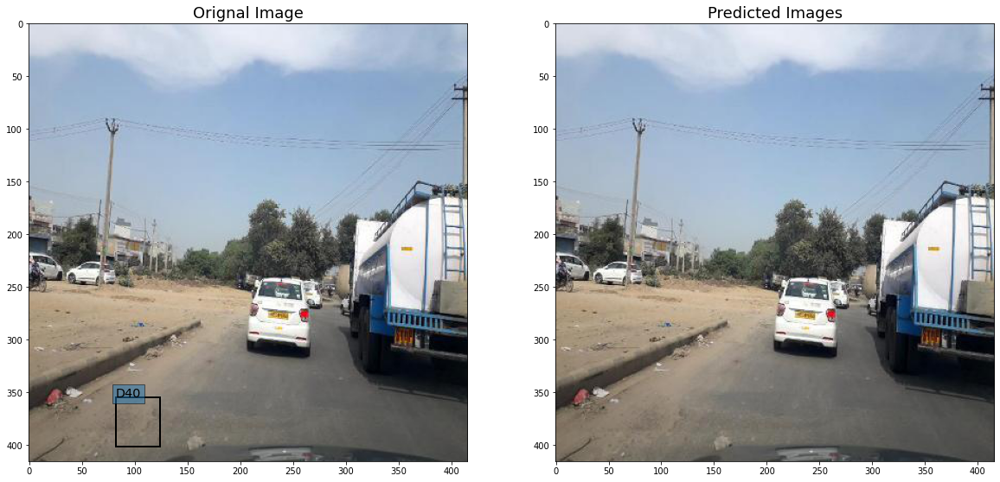

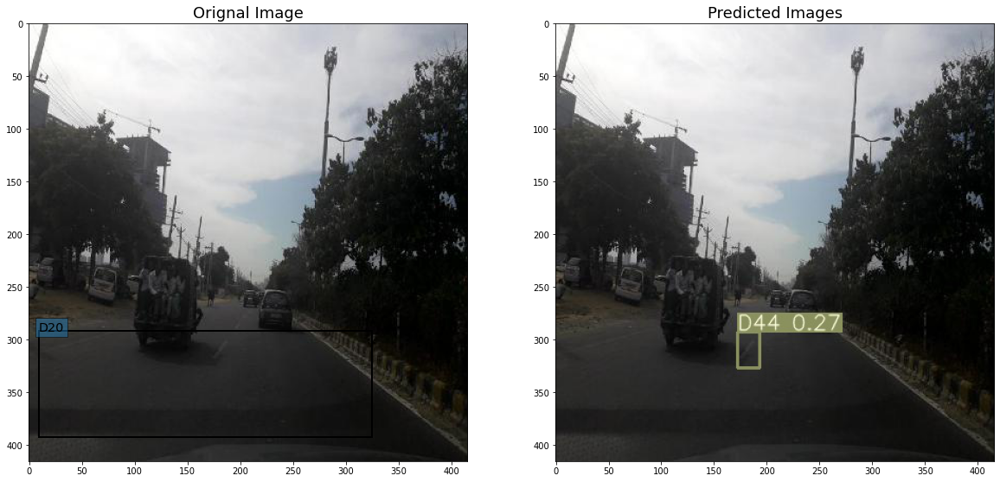

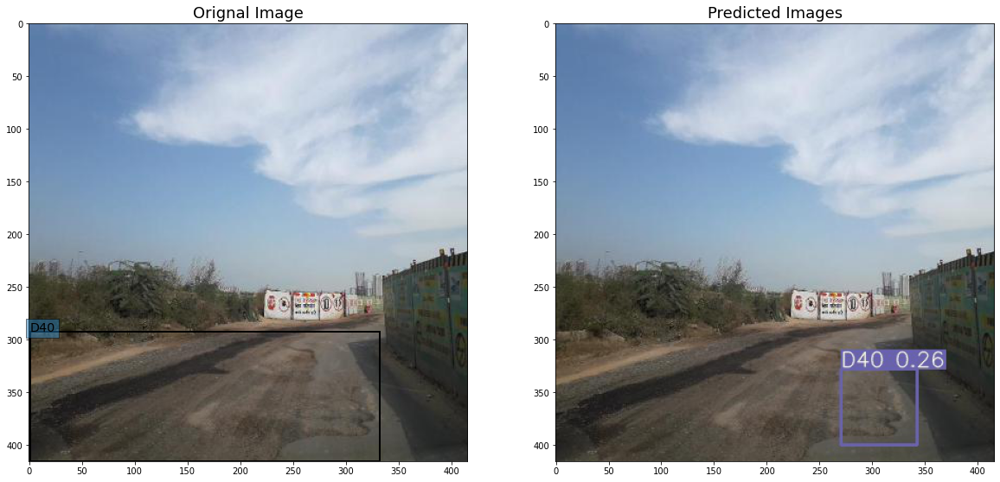

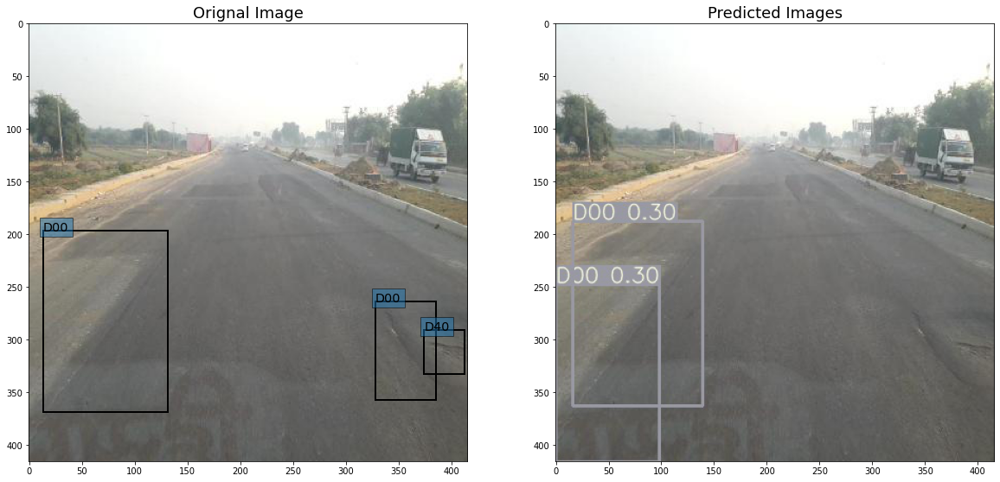

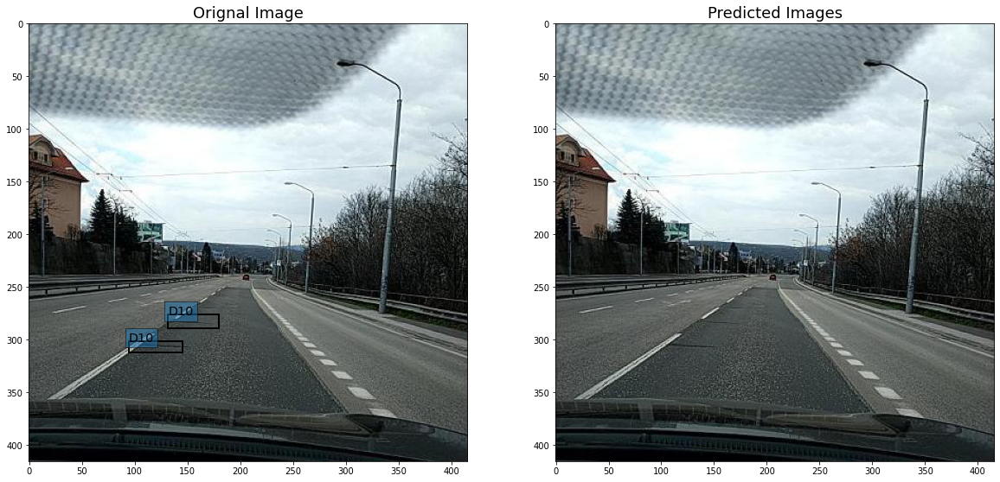

...

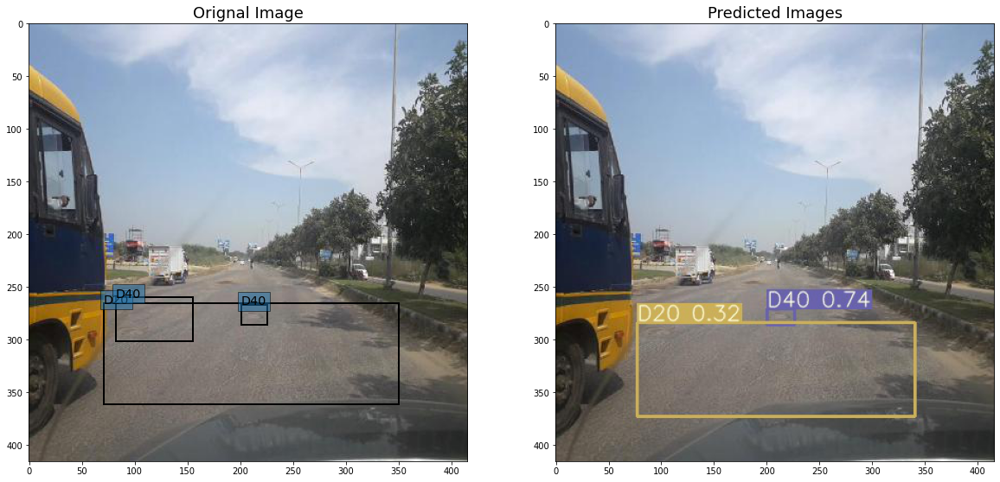

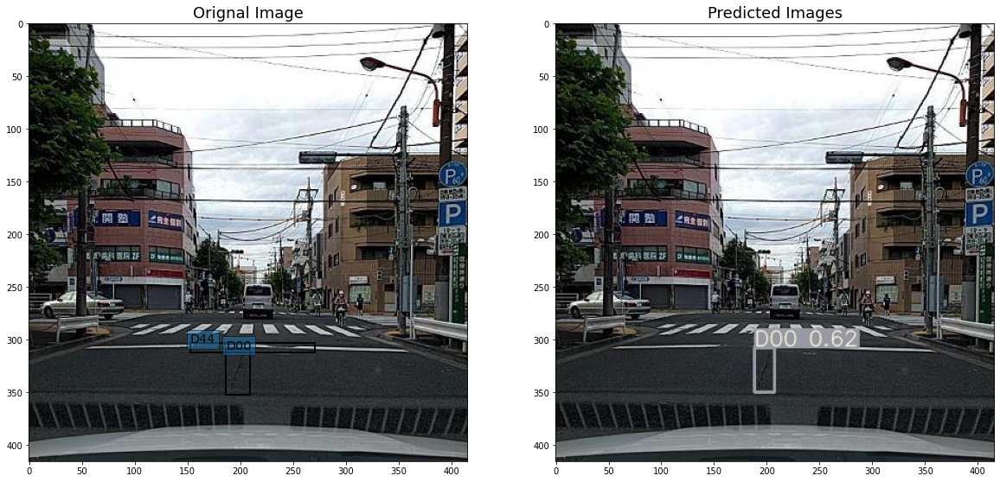

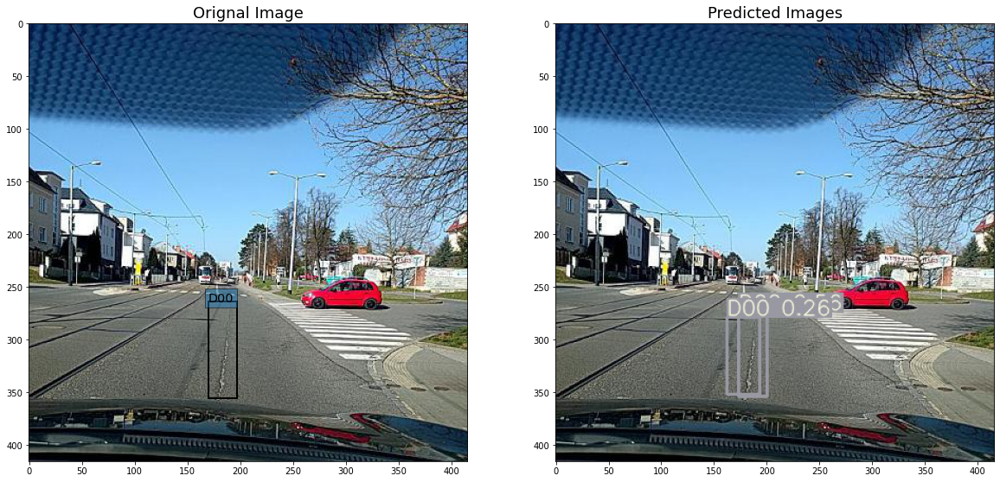

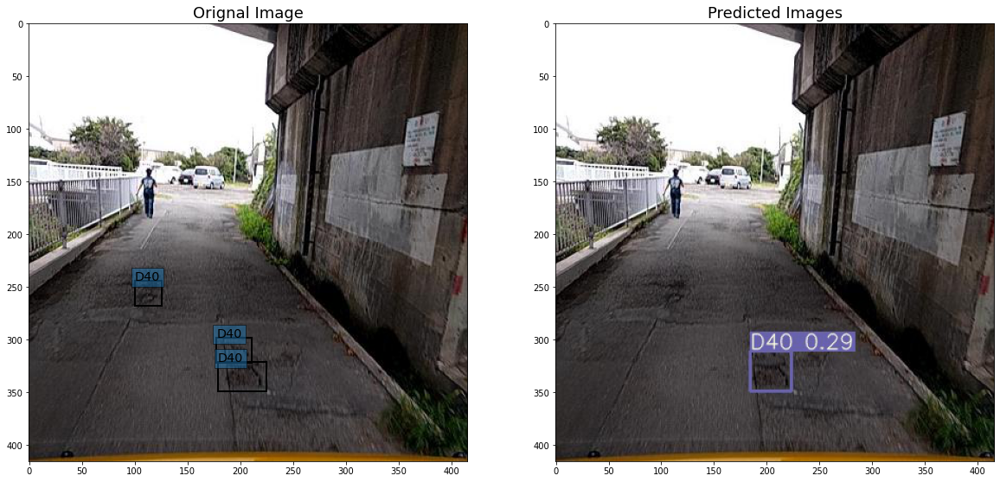

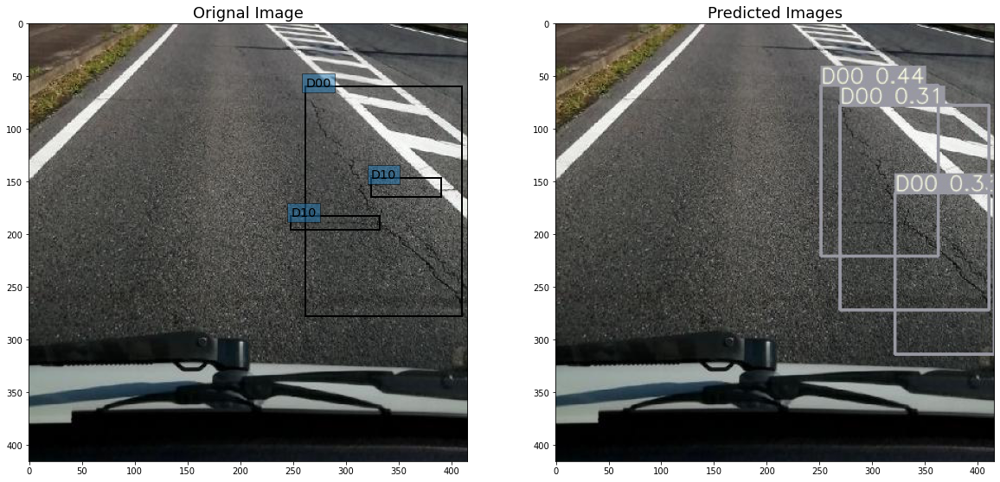

In [29]:

grouped_resized = test_label.groupby('filename')
#grouped_augmented = augmented_train_images_df.groupby('filename')

for filename in test_images:  
    fig, cell = plt.subplots(1, 2, figsize=(20,16))
  
    group_r_df = grouped_resized.get_group(filename)
    group_r_df = group_r_df.reset_index()
    group_r_df = group_r_df.drop(['index'], axis=1)
    bb_r_array = group_r_df.drop(['filename', 'width', 'height'], axis=1).values
    resized_img = imageio.imread('/content/drive/MyDrive/YoloV3-Custom-Object-Detection/training/images/'+filename)
    img_array1 = np.asarray(resized_img)
    cell[0].imshow(img_array1)
    #bbs_r = BoundingBoxesOnImage.from_xyxy_array(bb_r_array, shape=resized_img.shape)
    #print(bb_r_array)
    for box in bb_r_array:
      xmin = box[1]
      ymin = box[2]
      xmax = box[3]
      ymax = box[4]
     # color = colors[int(box[0])]
      label = '{}'.format(box[0])
      cell[0].set_title('Orignal Image',fontsize = 18)
      cell[0].add_patch(plt.Rectangle((xmin, ymin), xmax-xmin, ymax-ymin, fill=False, linewidth=2))  
      cell[0].text(xmin, ymin, label, size='x-large', color='black', bbox={'alpha':0.5})

    
   

    augmented_img = imageio.imread('/content/drive/MyDrive/YoloV3-Custom-Object-Detection/output/'+filename)
    img_array2 = np.asarray(augmented_img)
    cell[1].imshow(img_array2)
    cell[1].set_title('Predicted Images',fontsize = 18)

 

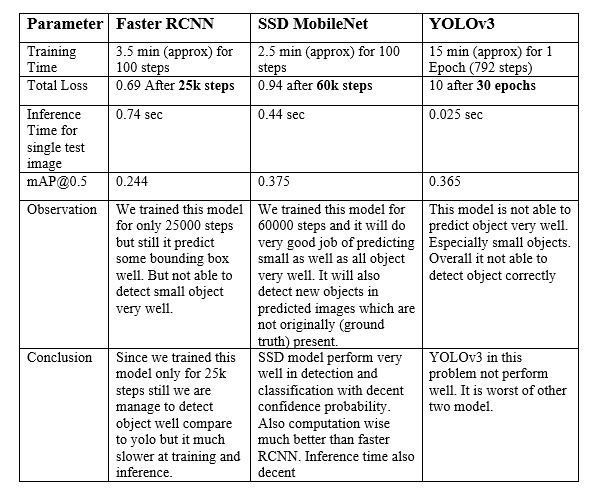